# Testing Accuracy

In [ ]:
# Introduction to Neural Networks (CSE 60868)
# University of Notre Dame
# Deliverable 4
# Name: Pedro Antonio Alarcon (palarcon)
# _________________________________________________________________________________________
# Professor: Adam Czajka

In [ ]:
!pip install pyyaml==5.1
import torch
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
# Install detectron2 that matches the above pytorch version
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/$CUDA_VERSION/torch$TORCH_VERSION/index.html
# If there is not yet a detectron2 release that matches the given torch + CUDA version, you need to install a different pytorch.

#exit(0)  # After installation, you may need to "restart runtime" in Colab. This line can also restart runtime
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
!pip install opencv-python
import numpy as np
import os, json, cv2, random
import matplotlib.pyplot as plt
import math
#from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.data.datasets import register_coco_instances
from detectron2.structures import BoxMode

torch:  1.10 ; cuda:  cu111
Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.10/index.html


In [ ]:
#uncoment when working on Google Colab
from google.colab import drive
drive.mount("/content/gdrive")

Mounted at /content/gdrive


I used https://plainsight.ai to perform polygon annotations and exported the data utilizing their COCO format feature. However, the images segmentations are exported in the following format "segmentation" : [[x_1, y_1], [x_2, y_2], ...] which is not the format expected from detectron2. Thefore, we first need to flatten the segmentation array of arrays prior to registering with detectron. The cell below takes care of that

In [ ]:
'''
Function below accepts a path to a json_file with similar COCO structure and flattents the segmentations  array
i.e. [[x_1, y_1], [x_2, y_2], ...] will be converted to [x_1, y_1, x_2, y_2, ...]. This is the format 
Detectron2 is expecting
'''
def convert_to_COCO(json_path):
  #variable where we will save our new json object
    new_json = None
    
    with open(json_path, 'r') as file:
        json_object = json.load(file)
        annotations = json_object['annotations']
    #function to flatten the array of arrays
    for i in range(0, len(annotations)):
        annotations[i]["segmentation"]  =  [np.array(annotations[i]["segmentation"]).flatten().tolist()]

    #save to json object 
    json_object['annotations'] = annotations

    new_json = json_object
    return new_json


'''
function to save a json file to selected path, note we should append the name of the file
'''
def save_JSON(data, path):
    with open(path, 'w') as f:
        json.dump(data, f, indent=4)


#Google colab path
#dataset_path = "/content/gdrive/MyDrive/Amazon Project/Amazon-Robotics-snapshot-001-project-coco-1646593032"
#
dataset_path = '/content/gdrive/MyDrive/Amazon Project/clutterized'
#scratch365 path
#dataset_path = "./Amazon-Robotics-snapshot-001-project-coco-1646593032"
old_annotations_train = dataset_path + "/train.json"
image_path = dataset_path 


new_json_train = convert_to_COCO(dataset_path + "/train.json")
save_JSON(new_json_train, dataset_path+"/new_train.json")
annotations_train = dataset_path + "/new_train.json"



In [ ]:
#telling detectron what to call my training dataset, path to json file, and path to images
register_coco_instances("my_dataset_train", {}, annotations_train, image_path)

# Importing Trained Model

In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 600  # 600 iterations seems decent results
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 200  # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 10  # 10 classes in our customized set. (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.


cfg.MODEL.WEIGHTS = "/content/gdrive/MyDrive/Amazon Project/clutterized/output/model_final.pth"  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

# Testing Validation/Inference

Utility Method to generate the image details from a directory of images and write it to an existing COCO JSON file:



In [ ]:
from PIL import Image
import glob
  
def add_images_to_coco(image_dir, coco_filename):
    image_filenames = glob.glob(image_dir, recursive = True)
    images = []
    for i, image_filename in enumerate(image_filenames):
        im = Image.open(image_filename)
        width, height = im.size
        image_details = {
            "id": i + 1,
            "height": height,
            "width": width,
            "file_name": str(os.path.basename(image_filename)),
        }
        images.append(image_details)

    # This will overwrite the image tags in the COCO JSON file
    with open(coco_filename) as f:
        data = json.load(f)

        data['images'] = images

    with open(coco_filename, 'w') as coco_file:
        json.dump(data, coco_file, indent = 4)


In [ ]:
#path to test set images from top view and top light configuration
#google colab path
test_dataset_path = '/content/gdrive/MyDrive/Amazon Project/clutterized dataset/'
#scratch365 path 
#test_dataset_path = './dataset_jpg/'

image_file_folders = ['layout one', 'layout two', 'layout three', 'layout four', 'layout five']

for folder in image_file_folders:
    image_directory = test_dataset_path + folder + "/*.jpeg"
    json_directory = test_dataset_path + folder + "/" + folder + '.json'
    print('Generating: ', json_directory)
    add_images_to_coco(image_directory, json_directory) #adds the image details, i.e. height, width, file name in the COCO Json file 



Generating:  /content/gdrive/MyDrive/Amazon Project/clutterized dataset/layout one/layout one.json
Generating:  /content/gdrive/MyDrive/Amazon Project/clutterized dataset/layout two/layout two.json
Generating:  /content/gdrive/MyDrive/Amazon Project/clutterized dataset/layout three/layout three.json
Generating:  /content/gdrive/MyDrive/Amazon Project/clutterized dataset/layout four/layout four.json
Generating:  /content/gdrive/MyDrive/Amazon Project/clutterized dataset/layout five/layout five.json


Registering all 6 different test dataset configurations. This tells detectron what to call my validation tests.

In [ ]:
for folder in image_file_folders:
    name = folder + '_val'
    json_directory = test_dataset_path + folder + "/" + folder + '.json'
    register_coco_instances(name, {}, json_directory, test_dataset_path + folder)

In [ ]:
from detectron2.utils.visualizer import ColorMode
import matplotlib.pyplot as plt

def visualize(dataset, metadata):
    rows, cols = math.ceil(len(dataset)/3), 3
    fig = plt.figure(figsize=(40,65))
    i = 0
    objects_detected = 0
    for d in dataset:  
        
        im = cv2.imread(d["file_name"])
        outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
        objects_detected = objects_detected + len(outputs["instances"])
        v = Visualizer(im[:, :, ::-1],
                    metadata=metadata, 
                    scale=0.2, 
                    instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
      )
        out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
        fig.add_subplot(rows, cols, i+1)
        im_name = d["file_name"].rsplit('/', 1)
        plt.gca().set_title(im_name[1]) 
        i = i+ 1
        plt.imshow(out.get_image()[:, :, ::-1])
    return objects_detected

## Training Data Accuracy 

[04/24 16:17:30 d2.data.datasets.coco]: Loaded 44 images in COCO format from /content/gdrive/MyDrive/Amazon Project/clutterized/new_train.json


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride
/usr/local/lib/python3.7/dist-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


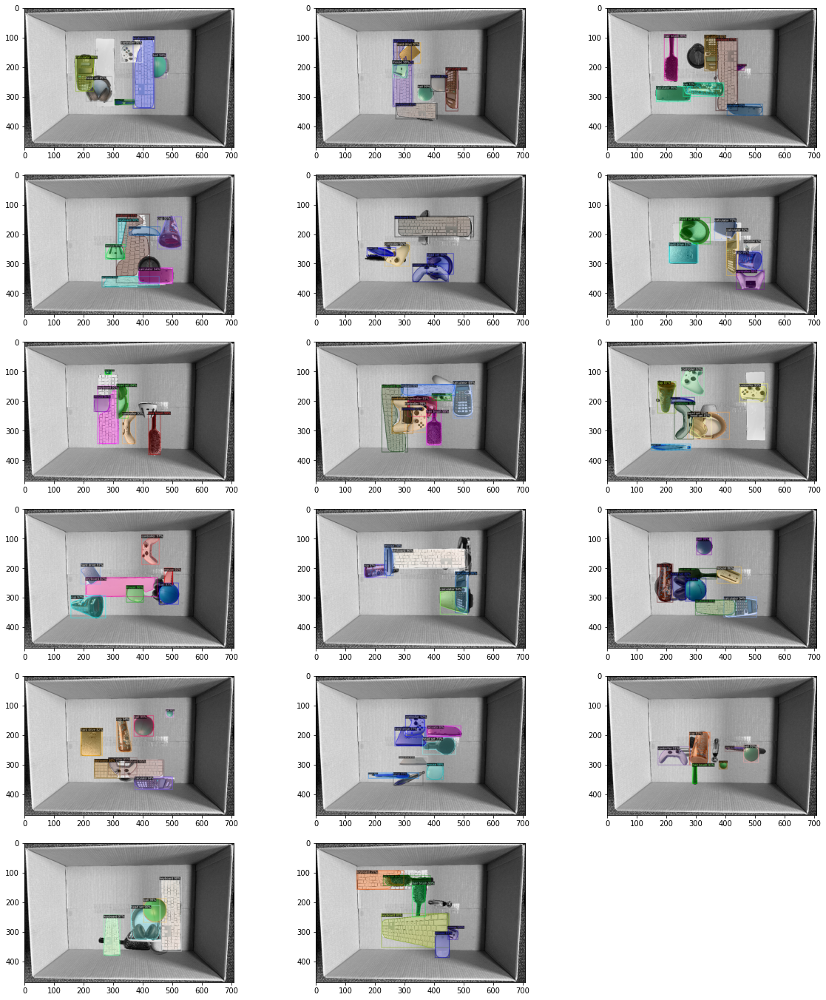

In [ ]:
#visualize 30 training data predictions
train_metadata = MetadataCatalog.get("my_dataset_train")
train_dataset = DatasetCatalog.get("my_dataset_train") #Call the registered function and return its results (return list[dict] – dataset annotations.)

rows, cols = 11, 3
fig = plt.figure(figsize=(20,45))
i = 0
for d in random.sample(train_dataset, 17):  
  

    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                metadata=train_metadata, 
                scale=0.2, 
                instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
  )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    fig.add_subplot(rows, cols, i+1)
    
    i = i+ 1
    plt.imshow(out.get_image()[:, :, ::-1])

In [ ]:
#import the COCO Evaluator to use the COCO Metrics
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

#Call the COCO Evaluator function and pass the Validation Dataset
evaluator = COCOEvaluator("my_dataset_train", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_train")

#Use the created predicted model in the previous step
inference_on_dataset(predictor.model, val_loader, evaluator)

WARNING [04/24 16:18:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[04/24 16:18:21 d2.data.datasets.coco]: Loaded 44 images in COCO format from /content/gdrive/MyDrive/Amazon Project/clutterized/new_train.json
[04/24 16:18:21 d2.data.build]: Distribution of instances among all 10 categories:
|  category  | #instances   |  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|:----------:|:-------------|
|    ball    | 26           | calculator | 43           | controller | 43           |
|    cup     | 38           | hair brush | 41           | hard drive | 29           |
|  head set  | 46           |  keyboard  | 50           |   mouse    | 41           |
|   tongs    | 35           |            |              |            |              |
|   total    | 392          |            |              |            |              |
[0

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


[04/24 16:18:38 d2.evaluation.evaluator]: Inference done 11/44. Dataloading: 0.0018 s/iter. Inference: 0.3717 s/iter. Eval: 0.9537 s/iter. Total: 1.3273 s/iter. ETA=0:00:43
[04/24 16:18:43 d2.evaluation.evaluator]: Inference done 15/44. Dataloading: 0.0023 s/iter. Inference: 0.3705 s/iter. Eval: 0.9605 s/iter. Total: 1.3336 s/iter. ETA=0:00:38
[04/24 16:18:50 d2.evaluation.evaluator]: Inference done 19/44. Dataloading: 0.0032 s/iter. Inference: 0.3726 s/iter. Eval: 1.0221 s/iter. Total: 1.3986 s/iter. ETA=0:00:34
[04/24 16:18:55 d2.evaluation.evaluator]: Inference done 23/44. Dataloading: 0.0042 s/iter. Inference: 0.3725 s/iter. Eval: 1.0249 s/iter. Total: 1.4026 s/iter. ETA=0:00:29
[04/24 16:19:01 d2.evaluation.evaluator]: Inference done 27/44. Dataloading: 0.0046 s/iter. Inference: 0.3711 s/iter. Eval: 1.0243 s/iter. Total: 1.4008 s/iter. ETA=0:00:23
[04/24 16:19:06 d2.evaluation.evaluator]: Inference done 31/44. Dataloading: 0.0047 s/iter. Inference: 0.3719 s/iter. Eval: 1.0113 s/it

OrderedDict([('bbox',
              {'AP': 60.45748001928397,
               'AP-ball': 78.83904461874761,
               'AP-calculator': 59.36550194197745,
               'AP-controller': 72.88707463183293,
               'AP-cup': 56.49560581476207,
               'AP-hair brush': 53.25913690270126,
               'AP-hard drive': 67.6741590308099,
               'AP-head set': 48.82662229374554,
               'AP-keyboard': 53.53099954035015,
               'AP-mouse': 75.28444057005429,
               'AP-tongs': 38.412214847858415,
               'AP50': 76.67605010370276,
               'AP75': 72.61229462399808,
               'APl': 63.984394268493475,
               'APm': 5.192519251925193,
               'APs': nan}),
             ('segm',
              {'AP': 63.74269460675998,
               'AP-ball': 88.46376811594203,
               'AP-calculator': 62.84841484148416,
               'AP-controller': 74.92161851931799,
               'AP-cup': 61.654283154067926,
     

## Layout One



[04/24 16:51:53 d2.data.datasets.coco]: Loaded 9 images in COCO format from /content/gdrive/MyDrive/Amazon Project/clutterized dataset/layout one/layout one.json


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


Objects Detected in Top Light Top View Configuration:  51


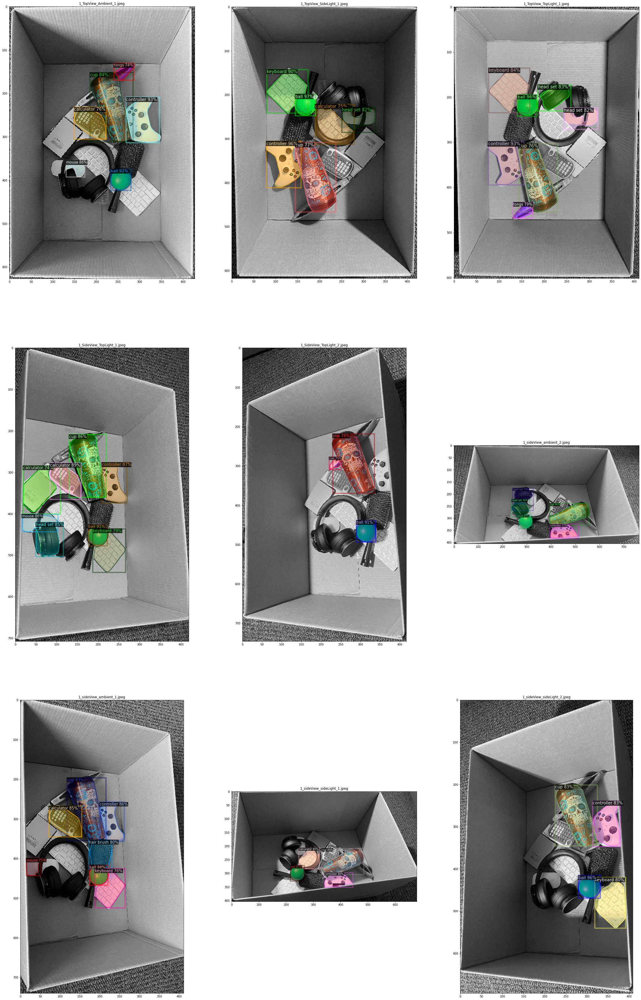

In [ ]:
#top_light_top_view
top_light_top_view_metadata = MetadataCatalog.get("layout one_val")
top_light_top_view_dataset = DatasetCatalog.get("layout one_val")

count = visualize(top_light_top_view_dataset, top_light_top_view_metadata)
print("Objects Detected in Top Light Top View Configuration: ", count)


## Layout Two

[04/24 16:59:38 d2.data.datasets.coco]: Loaded 9 images in COCO format from /content/gdrive/MyDrive/Amazon Project/clutterized dataset/layout two/layout two.json


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


Objects Detected in Top Light Size View Configuration:  38


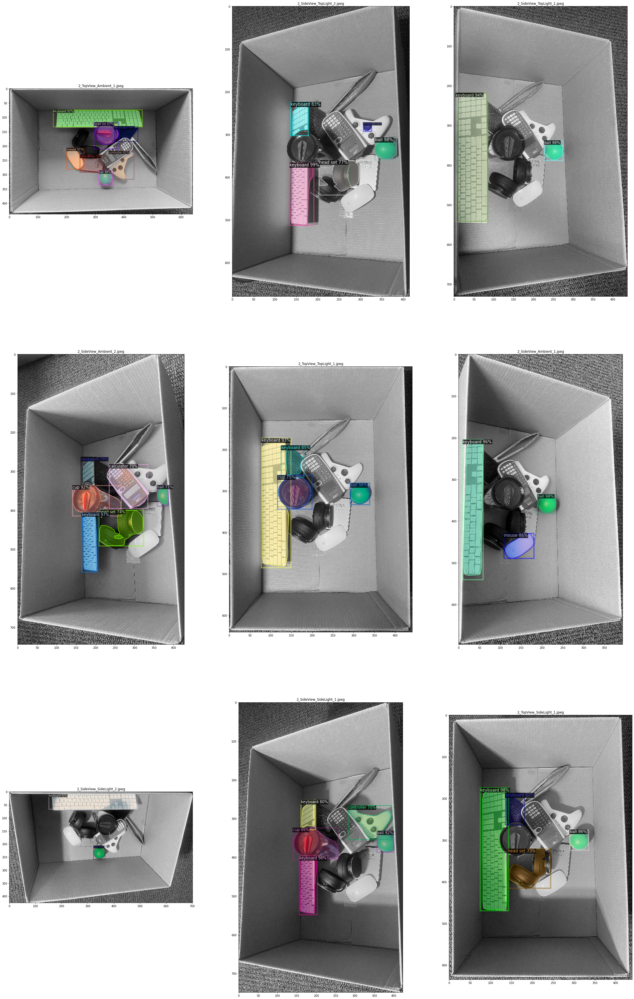

In [ ]:
#top_light_side_view
top_light_side_view_metadata = MetadataCatalog.get("layout two_val")
top_light_side_view_dataset = DatasetCatalog.get("layout two_val")

count = visualize(top_light_side_view_dataset, top_light_side_view_metadata)
print("Objects Detected in Top Light Size View Configuration: ", count)


## Layout Three

[04/24 17:27:09 d2.data.datasets.coco]: Loaded 9 images in COCO format from /content/gdrive/MyDrive/Amazon Project/clutterized dataset/layout three/layout three.json


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


Objects Detected in Side Light Side View Configuration:  67


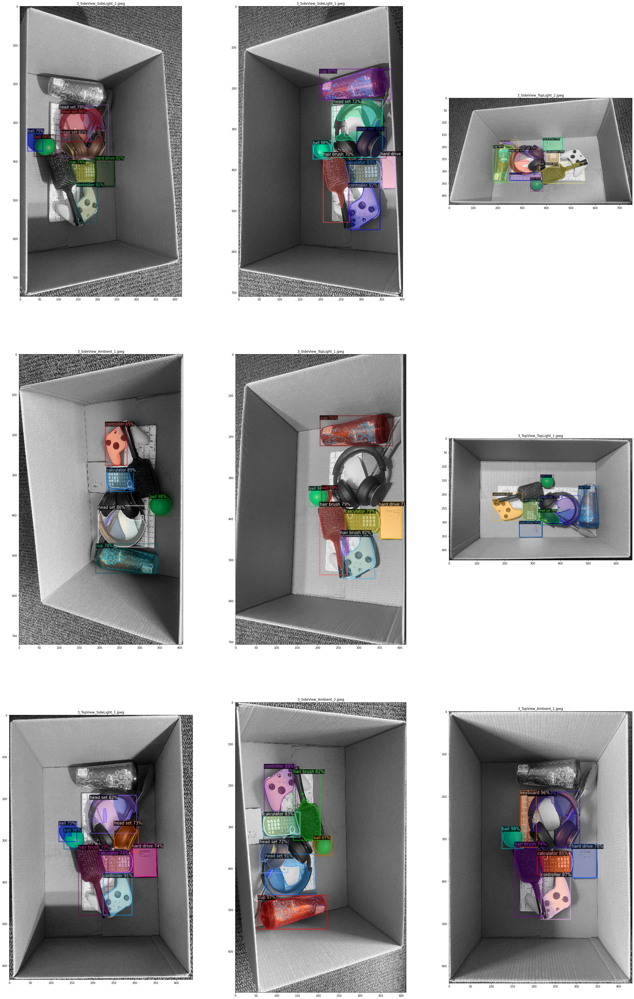

In [ ]:

#side_light_side_view
side_light_side_view_metadata = MetadataCatalog.get("layout three_val")
side_light_side_view_dataset = DatasetCatalog.get("layout three_val")

count  = visualize(side_light_side_view_dataset, side_light_side_view_metadata)
print("Objects Detected in Side Light Side View Configuration: ", count)

## Layout Four

[04/24 17:04:54 d2.data.datasets.coco]: Loaded 9 images in COCO format from /content/gdrive/MyDrive/Amazon Project/clutterized dataset/layout four/layout four.json


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


Objects Detected in Side Light Top View Configuration:  63


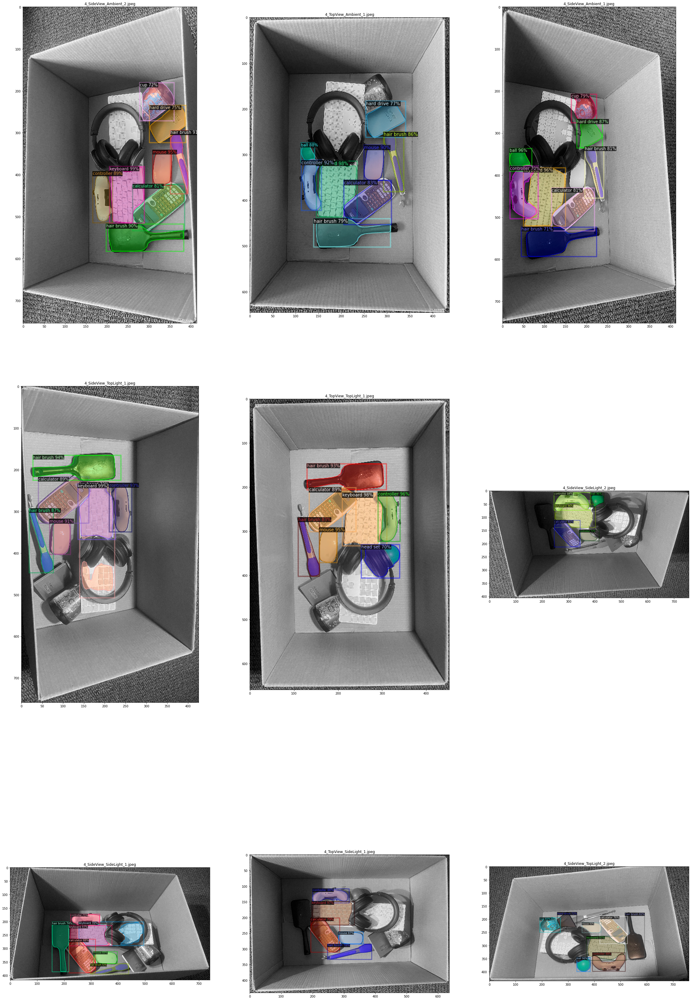

In [ ]:
#side_light_top_view
side_light_top_view_metadata = MetadataCatalog.get("layout four_val")
side_light_top_view_dataset = DatasetCatalog.get("layout four_val")

count  = visualize(side_light_top_view_dataset, side_light_top_view_metadata)
print("Objects Detected in Side Light Top View Configuration: ", count)

## Layout Five

[04/24 17:05:19 d2.data.datasets.coco]: Loaded 9 images in COCO format from /content/gdrive/MyDrive/Amazon Project/clutterized dataset/layout five/layout five.json


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


Objects Detected in Ambient Light Top View Configuration:  47


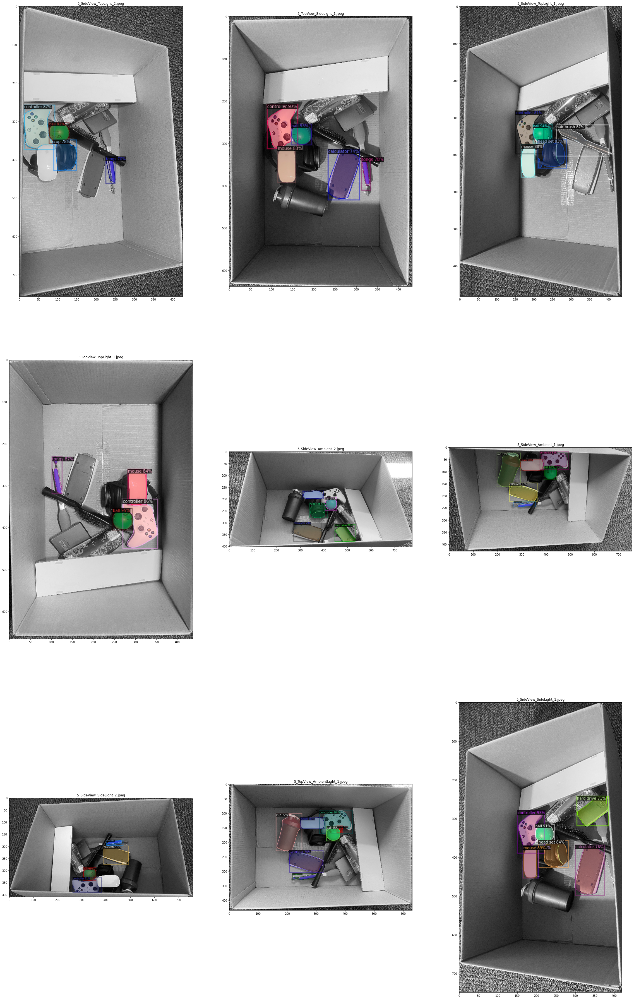

In [ ]:
#ambient_light_top_view
ambient_light_top_view_metadata = MetadataCatalog.get("layout five_val")
ambient_light_top_view_dataset = DatasetCatalog.get("layout five_val")

count = visualize(ambient_light_top_view_dataset, ambient_light_top_view_metadata)
print("Objects Detected in Ambient Light Top View Configuration: ", count)